In [2]:
%pylab inline
%matplotlib inline
import io
import h5py 
import pandas as pd
import scipy as sp
import numpy as np
from PIL import Image
from fractions import Fraction
from scipy.stats import norm, chisquare, chi2_contingency, chi2
from scipy import optimize 
from scipy.optimize import curve_fit,least_squares
from lmfit.models import GaussianModel
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.colorbar import ColorbarBase, make_axes_gridspec

Populating the interactive namespace from numpy and matplotlib


/Users/arthurshurley/anaconda3/lib/python3.7/site-packages/IPython/core/magics/pylab.py:160: UserWarning: pylab import has clobbered these variables: ['norm', 'chisquare']
`%matplotlib` prevents importing * from pylab and numpy
  "\n`%matplotlib` prevents importing * from pylab and numpy"


## corner trapezoid

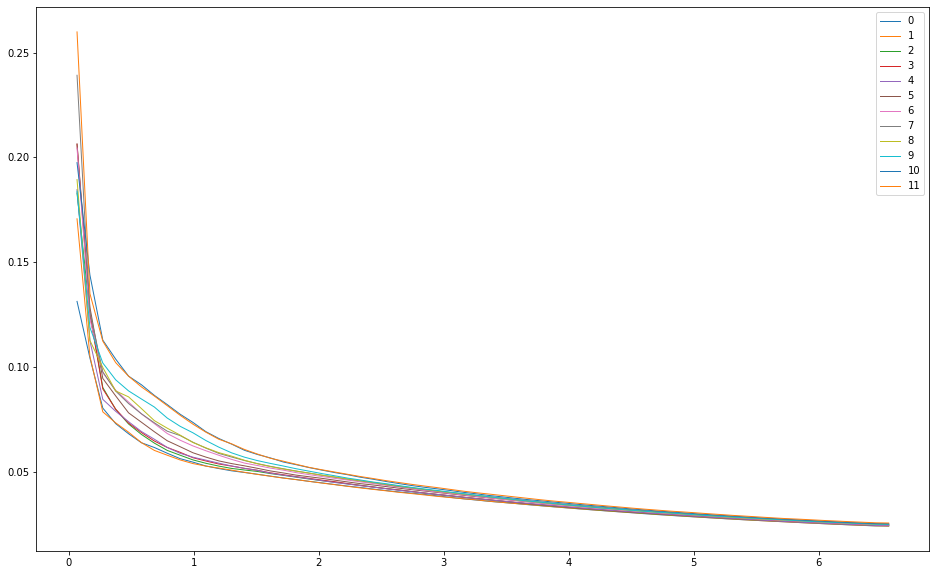

In [3]:

Angles = 12
fileName = [[] for i in range((Angles))]
dfs = []
numpydf = []
position = []
distance = []
for i in range(Angles):
    prefix1 = 'LXe_corner_LCE_nt_'    
    csv ='.csv'
    i=i  
    fileName[i].append(f'{prefix1}{i}{csv}')
    dfs.append(pd.read_csv(fileName[i][0], sep=',',header=None, skiprows=range(0,10),
                           names=('Energy Deposited', 'SiPM Hits', 'Photons',
                                 'x_pos','y_pos','z_pos')))  
    dfs[i]['LCE']=dfs[i]['SiPM Hits']/dfs[i]['Photons']
    dfs[i]['log(LCE)']=log(dfs[i]['SiPM Hits']/dfs[i]['Photons'])
    numpydf.append(dfs[i].to_numpy())
    position.append(numpydf[i][:,3:6])
    position[i][:,2]=position[i][:,2]-min(position[i][:,2])
    position[i]= position[i]/25.4
    distance.append(sqrt(sum(position[i]**2,axis=1)))
    dfs[i]['z_pos'] = position[i][:,2].tolist()
    dfs[i]['y_pos'] = position[i][:,1].tolist()
    dfs[i]['x_pos'] = position[i][:,0].tolist()
    

bins =64
mins = np.zeros((Angles))
maxs = np.zeros((Angles))
for i in range(Angles):
    mins[i]= np.min(distance[i])
    maxs[i]= np.max(distance[i])
xmin = np.min(mins) 
xmax = np.min(maxs)
be = np.linspace(xmin,xmax,bins+1)
bc = be[:-1] + np.diff(be) / 2.
average = np.zeros((Angles,bins))
for j in range(Angles):
    arraY = distance[j]
    for i in range(bins):
        msk = arraY>=be[i] 
        mask = arraY<be[i+1]
        mk = msk = mask
        average[j,i] = dfs[j]['LCE'][mk].mean()
plt.figure(figsize=(16,10))
for i in range(Angles):    
    plot(bc,average[i],label='{}'.format(i),lw=1)
legend()   
show()    

## center trapezoid

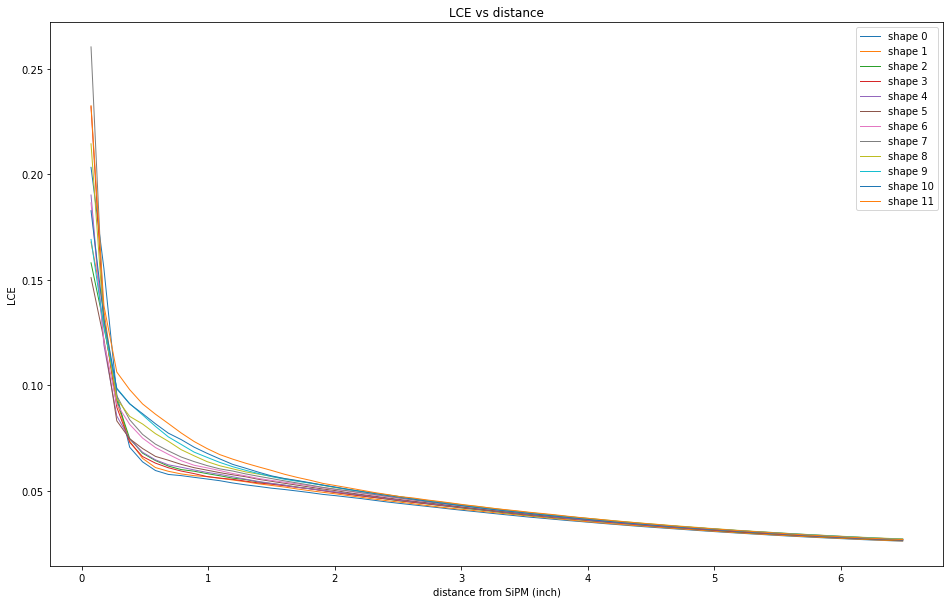

In [4]:

Angles_c = 12
fileName = [[] for i in range((Angles_c))]
dfs_c = []
numpydf_c = []
position_c = []
distance_c = []
for i in range(Angles_c):
    prefix1 = 'LXe_center_LCE_nt_'    
    csv ='.csv'
    i=i  
    fileName[i].append(f'{prefix1}{i}{csv}')
    dfs_c.append(pd.read_csv(fileName[i][0], sep=',',header=None, skiprows=range(0,10),
                           names=('Energy Deposited', 'SiPM Hits', 'Photons',
                                 'x_pos','y_pos','z_pos')))  
    dfs_c[i]['LCE']=dfs_c[i]['SiPM Hits']/dfs_c[i]['Photons']
    dfs_c[i]['log(LCE)']=log(dfs_c[i]['SiPM Hits']/dfs_c[i]['Photons'])
    numpydf_c.append(dfs_c[i].to_numpy())
    position_c.append(numpydf_c[i][:,3:6])
    position_c[i][:,2]=position_c[i][:,2]-min(position_c[i][:,2])
    position_c[i]= position_c[i]/25.4
    distance_c.append(sqrt(sum(position_c[i]**2,axis=1)))
    dfs_c[i]['z_pos'] = position_c[i][:,2].tolist()
    dfs_c[i]['y_pos'] = position_c[i][:,1].tolist()
    dfs_c[i]['x_pos'] = position_c[i][:,0].tolist()
bins =64
mins = np.zeros((Angles_c))
maxs = np.zeros((Angles_c))
for i in range(Angles_c):
    mins[i]= np.min(distance_c[i])
    maxs[i]= np.max(distance_c[i])
xmin = np.min(mins) 
xmax = np.min(maxs)
be = np.linspace(xmin,xmax,bins+1)
bc_c = be[:-1] + np.diff(be) / 2.
average_c = np.zeros((Angles_c,bins))
for j in range(Angles_c):
    arraY = distance_c[j]
    for i in range(bins):
        msk = arraY>=be[i] 
        mask = arraY<be[i+1]
        mk = msk = mask
        average_c[j,i] = dfs_c[j]['LCE'][mk].mean()
plt.figure(figsize=(16,10))
for i in range(Angles_c):
    plot(bc_c,average_c[i],label='shape {}'.format(i),lw=1)
legend()
plt.title('LCE vs distance')
plt.ylabel('LCE')
plt.xlabel('distance from SiPM (inch)')
show()   

##### Trap on both ends

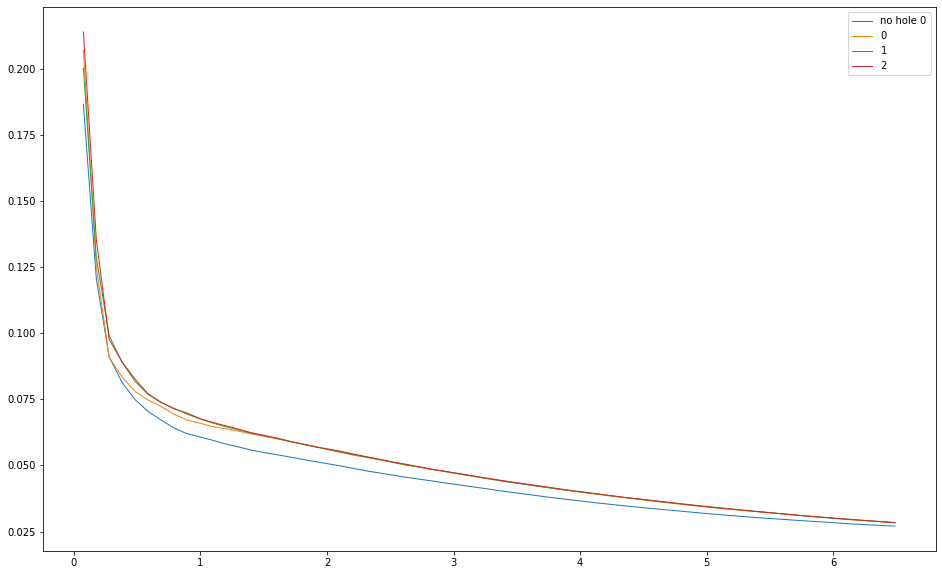

In [93]:
Angles_f = 3
fileName_f = [[] for i in range((Angles_f))]
dfs_f = []
numpydf_f = []
position_f = []
distance_f = []
for i in range(Angles_f):
    prefix1 = 'LXe_final_nt_'    
    csv ='.csv'
    i=i
    j = 5*i
    fileName_f[i].append(f'{prefix1}{j}{csv}')
    dfs_f.append(pd.read_csv(fileName_f[i][0], sep=',',header=None, skiprows=range(0,10),
                           names=('Energy Deposited', 'SiPM Hits', 'Photons',
                                 'x_pos','y_pos','z_pos')))  
    dfs_f[i]['LCE']=dfs_f[i]['SiPM Hits']/dfs_f[i]['Photons']
    dfs_f[i]['log(LCE)']=log(dfs_f[i]['SiPM Hits']/dfs_f[i]['Photons'])
    numpydf_f.append(dfs_f[i].to_numpy())
    position_f.append(numpydf_f[i][:,3:6])
    position_f[i][:,2]=position_f[i][:,2]-min(position_f[i][:,2])
    position_f[i]= position_f[i]/25.4
    distance_f.append(sqrt(sum(position_f[i]**2,axis=1)))
    dfs_f[i]['z_pos'] = position_f[i][:,2].tolist()
    dfs_f[i]['y_pos'] = position_f[i][:,1].tolist()
    dfs_f[i]['x_pos'] = position_f[i][:,0].tolist()
    

bins =64
mins_f = np.zeros((Angles_f))
maxs_f = np.zeros((Angles_f))
for i in range(Angles_f):
    mins_f[i]= np.min(distance_f[i])
    maxs_f[i]= np.max(distance_f[i])
xmin_f = np.min(mins_f) 
xmax_f = np.min(maxs_f)
be_f = np.linspace(xmin,xmax,bins+1)
bc_f = be_f[:-1] + np.diff(be_f) / 2.
average_f = np.zeros((Angles,bins))
for j in range(Angles_f):
    arraY = distance_f[j]
    for i in range(bins):
        msk = arraY>=be[i] 
        mask = arraY<be[i+1]
        mk = msk = mask
        average_f[j,i] = dfs_f[j]['LCE'][mk].mean()
plt.figure(figsize=(16,10))
plot(bc_c,average_c[6],label='no hole 0',lw=1)
for i in range(Angles_f):    
    plot(bc_f,average_f[i],label='{}'.format(i),lw=1)
 
legend()  
show()    

In [96]:
dfs_f[]

,Energy Deposited,SiPM Hits,Photons,x_pos,y_pos,z_pos,LCE,log(LCE)
0,0.382073,12,3059,0.044615,0.258034,1.256346,0.003923,-5.540937
1,0.285477,14,2264,0.159661,0.407075,1.318890,0.006184,-5.085831
2,0.075967,1,561,0.532398,0.560091,7.433807,0.001783,-6.329721
3,0.258177,32,2057,0.137235,-0.395142,3.191024,0.015557,-4.163268
4,0.272422,32,2132,0.046991,-0.477177,2.648976,0.015009,-4.199080
...,...,...,...,...,...,...,...,...
67048,0.063803,12,498,0.537268,-0.505953,1.309559,0.024096,-3.725693
67049,0.192576,6,1533,-0.547984,0.440114,6.530248,0.003914,-5.543222
67050,0.287483,54,2215,-0.437602,-0.514740,2.918945,0.024379,-3.714024
67051,0.491416,10,3874,0.478051,0.343085,7.444661,0.002581,-5.959458


## Most recent run with most hits

In [84]:
## Filter data ##
fileName = 'LXe_Final_nt_12.csv'  #  1.2 in far end trapezoid height
energy_deposit_threshold = 0.45
photon_threshold = 1000
SiPM_hit_threshold = 0
LCE_threshold = 0

dfs_0 = pd.read_csv(fileName, sep=',',header=None, skiprows=range(0,10),
                           names=('Energy Deposited', 'SiPM Hits', 'Photons',
                                 'x_pos','y_pos','z_pos'))
dfs_0['LCE']=dfs_0['SiPM Hits']/dfs_0['Photons']
dfs_0['log(LCE)']=log(dfs_0['SiPM Hits']/dfs_0['Photons'])
numpydf_0= dfs_0.to_numpy()
position_0=numpydf_0[:,3:6]
position_0[:,2]=position_0[:,2]-min(position_0[:,2])
position_0= position_0/25.4
distance_0= (sqrt(sum(position_0**2,axis=1)))
dfs_0['z_pos'] = position_0[:,2].tolist()
dfs_0['y_pos'] = position_0[:,1].tolist()
dfs_0['x_pos'] = position_0[:,0].tolist()
dfs_0['Distance'] = distance_0.tolist()
dfs_0 = dfs_0[dfs_0['Energy Deposited']>=energy_deposit_threshold]
dfs_0 = dfs_0[dfs_0['Photons']>=photon_threshold]
dfs_0 = dfs_0[dfs_0['LCE']>=LCE_threshold]
dfs_0 = dfs_0[dfs_0['SiPM Hits']>=SiPM_hit_threshold]

import plotly.express as px
fig = px.scatter_3d(dfs_filtered, x ='x_pos', y ='z_pos', z ='y_pos', color='log(LCE)')
fig.update_scenes(aspectmode='data')
fig.update_traces(opacity=1, selector=dict(type='scatter3d'))
fig.update_traces(marker_size=1, selector=dict(type='scatter3d'))
fig.update_traces(marker_colorscale='Hot', selector=dict(type='scatter3d'))
fig.show()
dfs_0



,Energy Deposited,SiPM Hits,Photons,x_pos,y_pos,z_pos,LCE,log(LCE),Distance
4,0.552070,63,4430,0.360547,0.396598,2.408756,0.014221,-4.253020,2.467669
7,0.479280,10,3784,-0.577232,-0.450173,5.384169,0.002643,-5.935952,5.433703
11,0.548183,29,4341,-0.014472,-0.247099,3.677380,0.006680,-5.008564,3.685701
19,0.467201,14,3739,0.005753,0.546224,6.433701,0.003744,-5.587516,6.456849
20,0.472632,18,3722,0.537146,0.236672,3.710969,0.004836,-5.331645,3.757104
...,...,...,...,...,...,...,...,...,...
86507,0.457057,165,3729,-0.418429,-0.585705,2.026760,0.044248,-3.117950,2.150788
86521,0.466587,67,3703,-0.587319,0.022555,2.829929,0.018093,-4.012206,2.890320
86524,0.457196,29,3677,-0.237443,0.511583,5.323642,0.007887,-4.842557,5.353434
86537,0.464427,57,3690,0.096605,-0.094554,3.670288,0.015447,-4.170330,3.672776


In [15]:
for i in range(Angles_f):
    print('\ntrap height index',i)
    print('{:.4f}'.format(dfs_f[i]['LCE'].mean()),' average LCE')
    


trap height index 0
0.0243  average LCE

trap height index 1
0.0250  average LCE

trap height index 2
0.0253  average LCE

trap height index 3
0.0258  average LCE

trap height index 4
0.0267  average LCE


In [ ]:
450-570

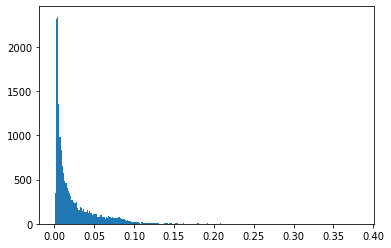

In [88]:
hist(dfs_0['LCE'], bins=256)
show()

# corner and center comparison at each SiPM side trapezoid
k=10
import plotly.express as px
fig = px.scatter_3d(dfs[k], x ='x_pos', y ='z_pos', z ='y_pos', color='log(LCE)')
fig.update_scenes(aspectmode='data')
fig.update_traces(opacity=1, selector=dict(type='scatter3d'))
fig.update_traces(marker_size=1, selector=dict(type='scatter3d'))
fig.update_traces(marker_colorscale='Hot', selector=dict(type='scatter3d'))
fig.show()

fig = px.scatter_3d(dfs_c[k], x ='x_pos', y ='z_pos', z ='y_pos', color='log(LCE)')
fig.update_scenes(aspectmode='data')
fig.update_traces(opacity=1, selector=dict(type='scatter3d'))
fig.update_traces(marker_size=1, selector=dict(type='scatter3d'))
fig.update_traces(marker_colorscale='Hot', selector=dict(type='scatter3d'))
fig.show()

In [8]:
print('Total SiPM hits Center trap normalize to rectangle')
for i in range(Angles_c):
    print('{:.3f}'.format(np.sum(dfs_c[i]['SiPM Hits'])/np.sum(dfs_c[0]['SiPM Hits'])),'Shape {}'.format(i))

Total SiPM hits Center trap normalize to rectangle
1.000 Shape 0
0.990 Shape 1
0.989 Shape 2
0.985 Shape 3
0.989 Shape 4
0.978 Shape 5
0.988 Shape 6
0.978 Shape 7
0.967 Shape 8
0.960 Shape 9
0.937 Shape 10
0.940 Shape 11


In [9]:
print('Total SiPM hits Corner trap normalize to rectangle')
for i in range(Angles):
    print('{:.3f}'.format(np.sum(dfs[i]['SiPM Hits'])/np.sum(dfs[0]['SiPM Hits'])),'Shape {}'.format(i))

Total SiPM hits Corner trap normalize to rectangle
1.000 Shape 0
0.986 Shape 1
0.994 Shape 2
1.005 Shape 3
0.986 Shape 4
0.992 Shape 5
0.983 Shape 6
0.984 Shape 7
0.981 Shape 8
0.973 Shape 9
0.971 Shape 10
0.972 Shape 11


In [10]:
print('Total SiPM hits Center trap normalize to number of hits')
for i in range(Angles_c):
    print('{:.3f}'.format(np.sum(dfs_c[i]['SiPM Hits'])/len(dfs_c[i])),'Shape {}'.format(i))

Total SiPM hits Center trap normalize to number of hits
57.046 Shape 0
57.009 Shape 1
57.473 Shape 2
57.815 Shape 3
58.099 Shape 4
58.678 Shape 5
58.988 Shape 6
58.468 Shape 7
58.721 Shape 8
58.277 Shape 9
57.873 Shape 10
57.759 Shape 11


In [11]:
print('Total SiPM hits Corner trap normalize to number of hits')
for i in range(Angles):
    print('{:.3f}'.format(np.sum(dfs[i]['SiPM Hits'])/len(dfs[i])),'Shape {}'.format(i))

Total SiPM hits Corner trap normalize to number of hits
52.183 Shape 0
52.154 Shape 1
52.702 Shape 2
53.831 Shape 3
53.011 Shape 4
54.020 Shape 5
53.637 Shape 6
54.481 Shape 7
53.984 Shape 8
54.092 Shape 9
54.723 Shape 10
55.226 Shape 11


In [12]:
print('Total SiPM hits Center trap per photons')
for i in range(Angles_c):
    print('{:.5f} %'.format(100*np.sum(dfs_c[i]['SiPM Hits'])/np.sum(dfs_c[i]['Photons'])),'Shape {}'.format(i))

Total SiPM hits Center trap per photons
2.54832 % Shape 0
2.54656 % Shape 1
2.56424 % Shape 2
2.56596 % Shape 3
2.59169 % Shape 4
2.61106 % Shape 5
2.63164 % Shape 6
2.61195 % Shape 7
2.62087 % Shape 8
2.60212 % Shape 9
2.59553 % Shape 10
2.58154 % Shape 11


In [13]:
print('Total SiPM hits Corner trap per photons')
for i in range(Angles):
    print('{:.5f} %'.format(100*np.sum(dfs[i]['SiPM Hits'])/np.sum(dfs[i]['Photons'])),'Shape {}'.format(i))

Total SiPM hits Corner trap per photons
2.32218 % Shape 0
2.33257 % Shape 1
2.35461 % Shape 2
2.39425 % Shape 3
2.37079 % Shape 4
2.40395 % Shape 5
2.38061 % Shape 6
2.42973 % Shape 7
2.40775 % Shape 8
2.40874 % Shape 9
2.42951 % Shape 10
2.45787 % Shape 11


In [20]:
print('Total SiPM hits Center trap per photons')
for i in range(Angles_c):
    print('{:.5f} %'.format(100*np.sum(dfs_c[i]['SiPM Hits'])/np.sum(dfs_c[i]['Photons'])),'Shape {}'.format(i))

Total SiPM hits Center trap per photons
2.54832 % Shape 0
2.54656 % Shape 1
2.56424 % Shape 2
2.56596 % Shape 3
2.59169 % Shape 4
2.61106 % Shape 5
2.63164 % Shape 6
2.61195 % Shape 7
2.62087 % Shape 8
2.60212 % Shape 9
2.59553 % Shape 10
2.58154 % Shape 11


In [34]:
for i in range(Angles_f):
    

    fig = px.scatter_3d(dfs_f[i], x ='x_pos', y ='z_pos', z ='y_pos', color='log(LCE)')
    fig.update_scenes(aspectmode='data')
    fig.update_traces(opacity=1, selector=dict(type='scatter3d'))
    fig.update_traces(marker_size=1, selector=dict(type='scatter3d'))
    fig.update_traces(marker_colorscale='Hot', selector=dict(type='scatter3d'))
    fig.show()

In [22]:
k =1
fig = px.scatter_3d(dfs_f[k], x ='x_pos', y ='z_pos', z ='y_pos', color='log(LCE)')
fig.update_scenes(aspectmode='data')
fig.update_traces(opacity=1, selector=dict(type='scatter3d'))
fig.update_traces(marker_size=1, selector=dict(type='scatter3d'))
fig.update_traces(marker_colorscale='Hot', selector=dict(type='scatter3d'))
fig.show()

## double trap data

0


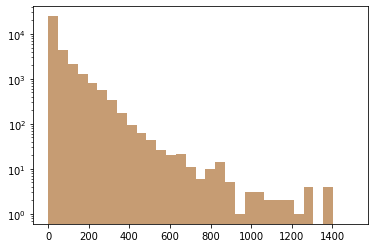

1


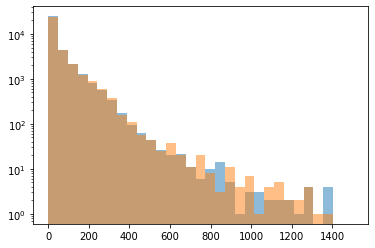

2


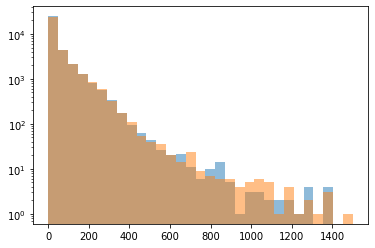

3


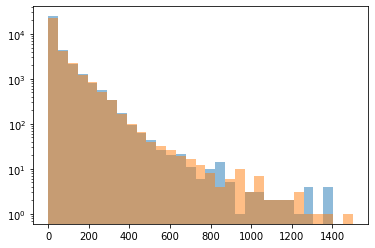

In [49]:
for i in range(Angles_f):
    print(i)
    bc = np.linspace(0,1500,32)
    histo = hist((dfs_f[0]['SiPM Hits']),bins=bc,log=True ,alpha=0.5)
    histo_c = hist((dfs_f[i]['SiPM Hits']),bins=bc,log=True, alpha=0.5)
   
    show()

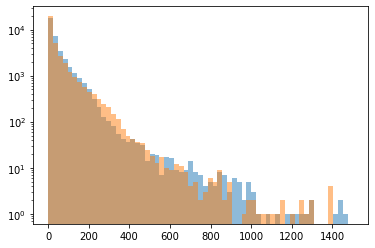

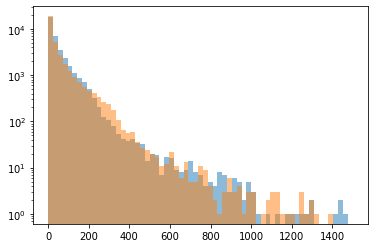

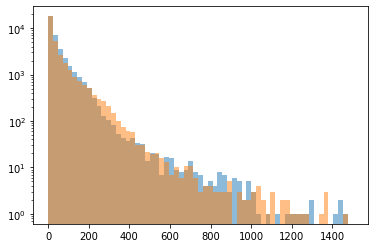

IndexError: list index out of range

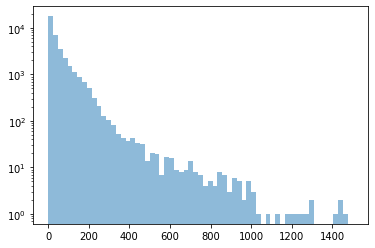

In [33]:
bc = np.linspace(0,1500,64)

for i in range(Angles):
    histo = hist((dfs[6]['SiPM Hits']),bins=bc,log=True ,alpha=0.5)
    histo_f = hist((dfs_f[i]['SiPM Hits']),bins=bc,log=True, alpha=0.5)
    

    
    show()